<a href="https://colab.research.google.com/github/hitarthi45/Machine-Learning/blob/main/Experiment/Multivariable_linear_regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
columns = ['area','rooms','price']
dataset = pd.read_csv("https://raw.githubusercontent.com/nishithkotak/machine-learning/refs/heads/master/ex1data2.txt",names=columns)

In [ ]:
dataset

,area,rooms,price
0,2104,3,399900
1,1600,3,329900
2,2400,3,369000
3,1416,2,232000
4,3000,4,539900
5,1985,4,299900
6,1534,3,314900
7,1427,3,198999
8,1380,3,212000
9,1494,3,242500


In [ ]:
dataset.describe();

In [ ]:
area=dataset.iloc[0:dataset.shape[0],0:1]
rooms=dataset.iloc[0:dataset.shape[0],1:2]
price=dataset.iloc[0:dataset.shape[0],2:3]

In [ ]:
dataset.shape

(47, 3)

In [ ]:
#normalise function
def feature_normalisation(x):
  mean=np.mean(x,axis=0)
  std=np.std(x,axis=0)
  x_normalised=(x-mean)/std
  return x_normalised,mean,std

In [ ]:
data_norm = dataset.values
m=data_norm.shape[0]
#take feature vectors
x2=data_norm[:,0:2].reshape(m,2)
x2_norm,mean,std=feature_normalisation(x2)

y1=data_norm[:,0:2].reshape(m,2)

In [ ]:
x2_norm

array([[ 1.31415422e-01, -2.26093368e-01],
       [-5.09640698e-01, -2.26093368e-01],
       [ 5.07908699e-01, -2.26093368e-01],
       [-7.43677059e-01, -1.55439190e+00],
       [ 1.27107075e+00,  1.10220517e+00],
       [-1.99450507e-02,  1.10220517e+00],
       [-5.93588523e-01, -2.26093368e-01],
       [-7.29685755e-01, -2.26093368e-01],
       [-7.89466782e-01, -2.26093368e-01],
       [-6.44465993e-01, -2.26093368e-01],
       [-7.71822042e-02,  1.10220517e+00],
       [-8.65999486e-04, -2.26093368e-01],
       [-1.40779041e-01, -2.26093368e-01],
       [ 3.15099326e+00,  2.43050370e+00],
       [-9.31923697e-01, -2.26093368e-01],
       [ 3.80715024e-01,  1.10220517e+00],
       [-8.65782986e-01, -1.55439190e+00],
       [-9.72625673e-01, -2.26093368e-01],
       [ 7.73743478e-01,  1.10220517e+00],
       [ 1.31050078e+00,  1.10220517e+00],
       [-2.97227261e-01, -2.26093368e-01],
       [-1.43322915e-01, -1.55439190e+00],
       [-5.04552951e-01, -2.26093368e-01],
       [-4.

In [ ]:
theta_array=np.zeros((3,1))

In [ ]:
#hypothesis
def hypothesis():
  return np.dot(x2_norm,theta_array)


In [ ]:
def cost_function(theta_array, x, x2):
  errors=0
  for i in range(m):
    errors = errors + ((theta_array[0]+theta_array[1]*x2[i])-x2[i])*2

  return errors/(2*m)

In [ ]:
def gradient_descent(theta_array, x, x2, m, alpha):
  sum0=0
  sum1=0
  sum2=0
  for i in range(m):
    prediction = theta_array[0] + theta_array[1]*x2[i, 0] + theta_array[2]*x2[i, 1]
    sum0 += (prediction - x[i])
    sum1 += (prediction - x[i]) * x2[i, 0]
    sum2 += (prediction - x[i]) * x2[i, 1]

  new_theta0 = theta_array[0] - alpha * (sum0/m)
  new_theta1 = theta_array[1] - alpha * (sum1/m)
  new_theta2 = theta_array[2] - alpha * (sum2/m)

  return np.array([new_theta0, new_theta1, new_theta2]).reshape(-1, 1)

In [ ]:
def training(x, y, alpha, iters):
  theta_array = np.zeros((3, 1))
  cost_values = []
  m = len(x)

  # Add a column of ones to x for the intercept term
  x_with_intercept = np.hstack((np.ones((m, 1)), x))

  for i in range(iters):
    theta_array = gradient_descent(theta_array, y, x_with_intercept, m, alpha)
    cost = cost_function(theta_array, y, x_with_intercept)
    cost_values.append(cost)

    # Plotting inside the loop might be too slow and produce many plots.
    # It's better to plot after training is complete.
    y_predict = x_with_intercept @ theta_array
    plt.plot(x, y_predict, 'r')
    plt.scatter(x[:, 0], y) # Assuming x[:, 0] is the first feature for plotting
    plt.show()

  return cost_values, theta_array

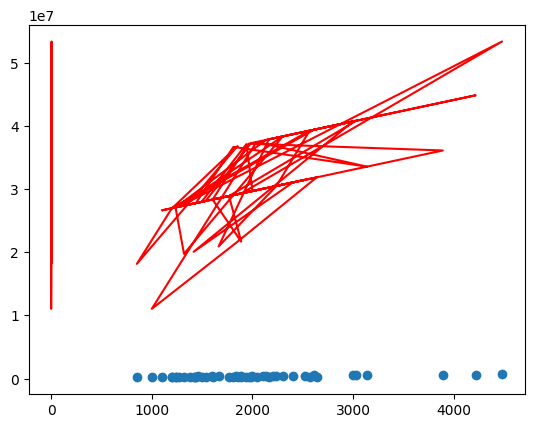

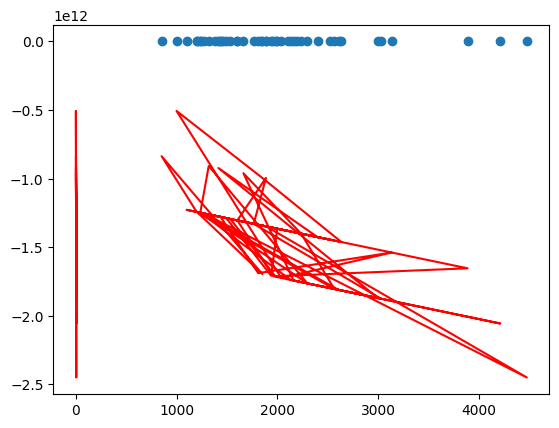

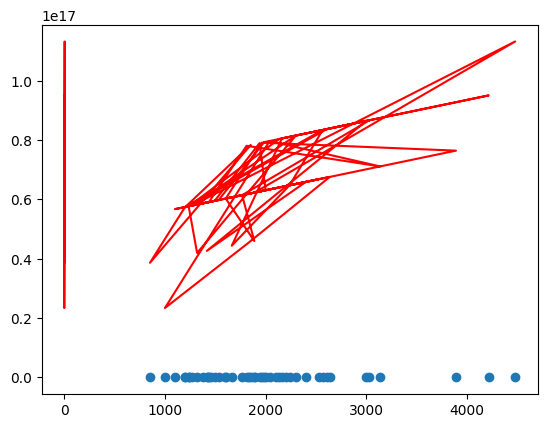

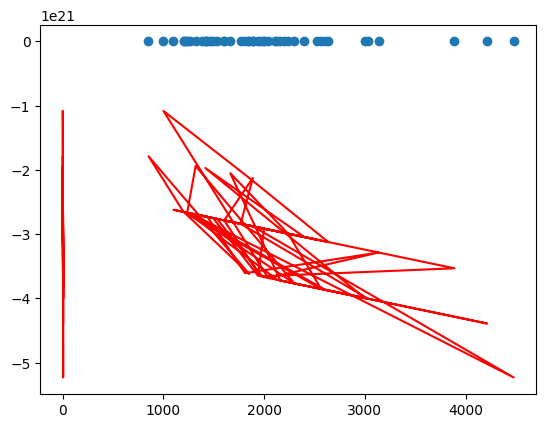

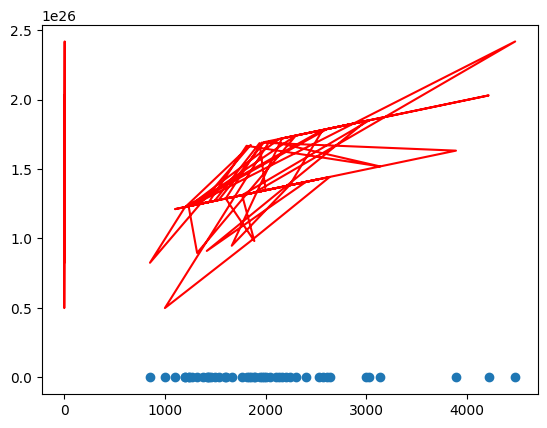

...

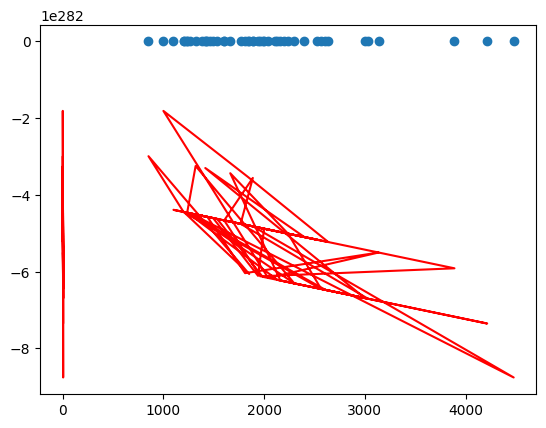

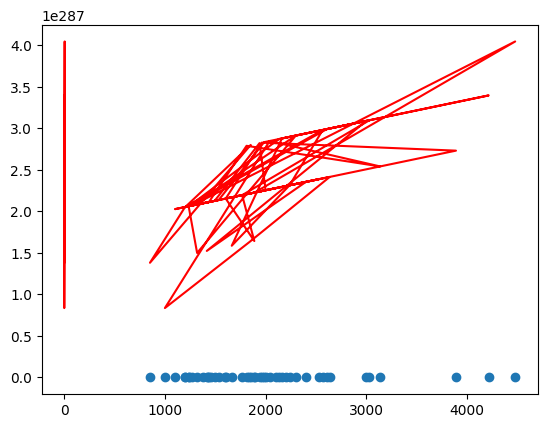

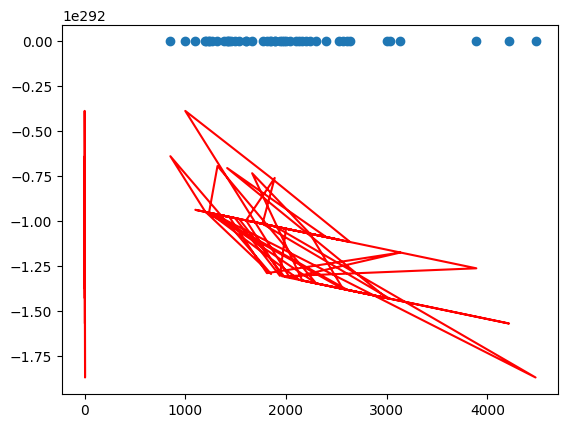

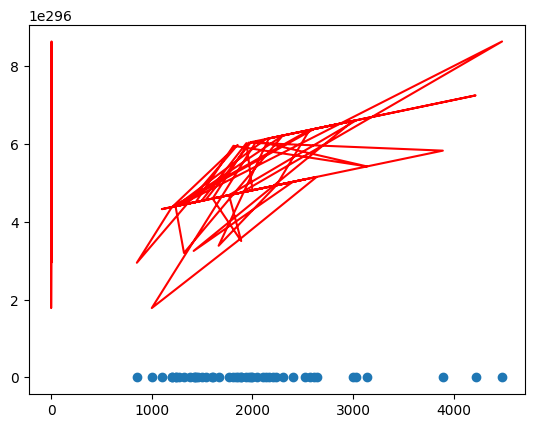

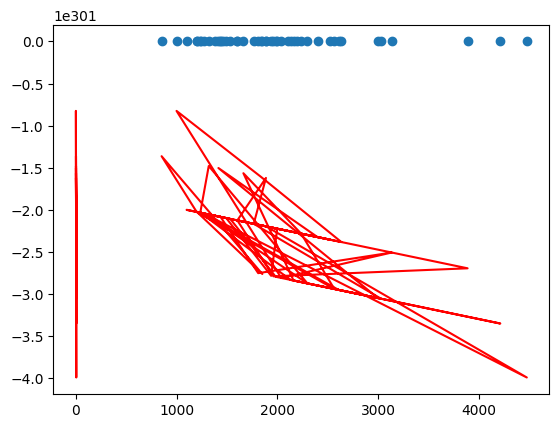

/tmp/ipython-input-3018676365.py:9: RuntimeWarning: overflow encountered in add
  sum2 += (prediction - x[i]) * x2[i, 1]


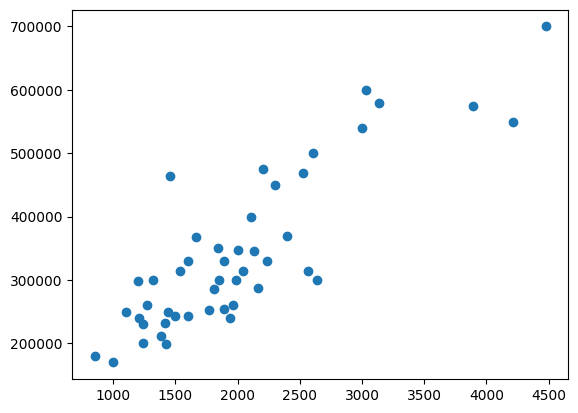

/tmp/ipython-input-3018676365.py:13: RuntimeWarning: invalid value encountered in subtract
  new_theta2 = theta_array[2] - alpha * (sum2/m)


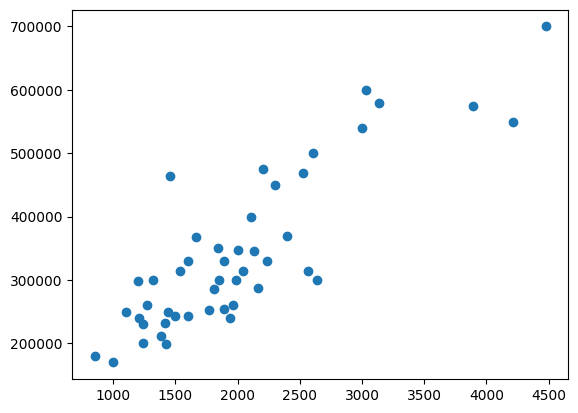

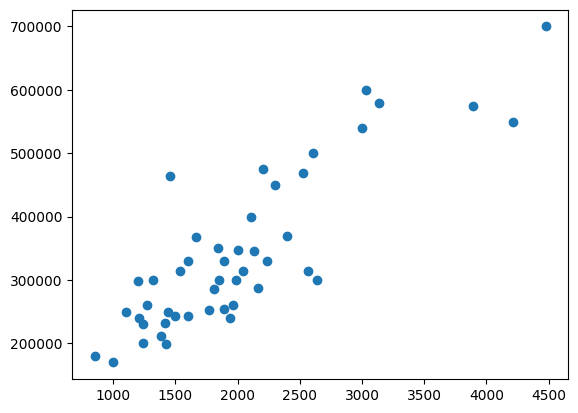

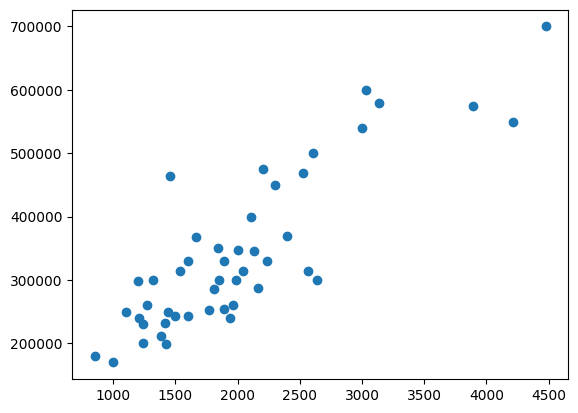

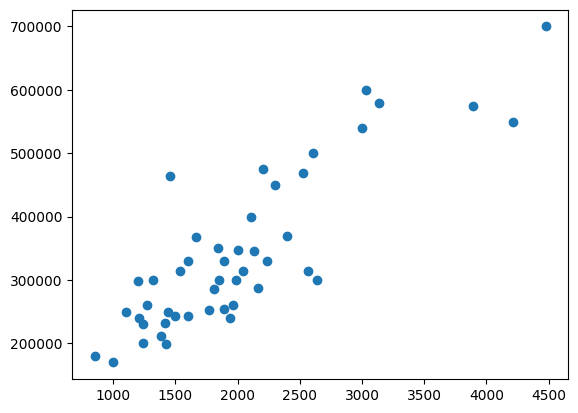

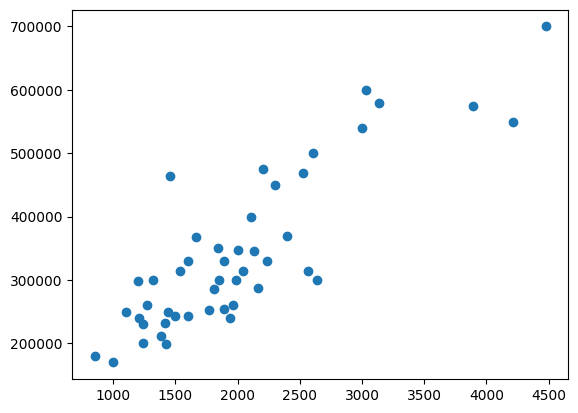

...

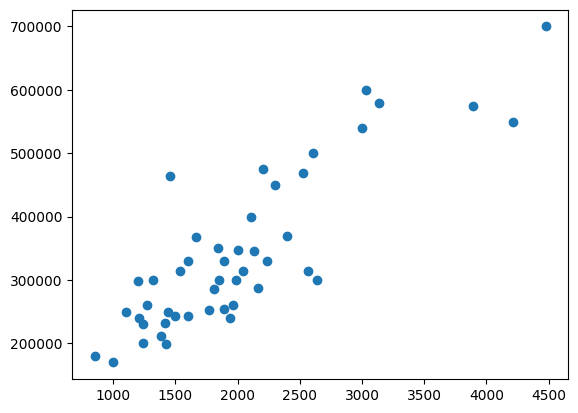

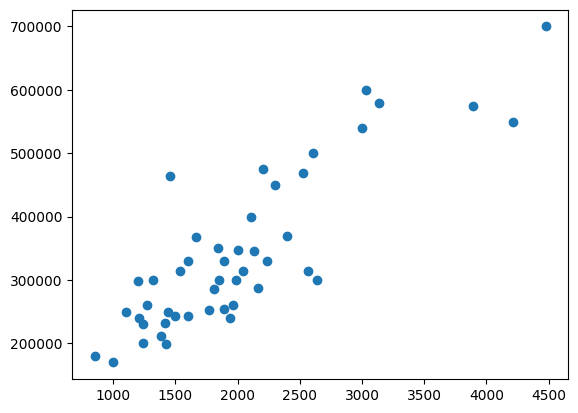

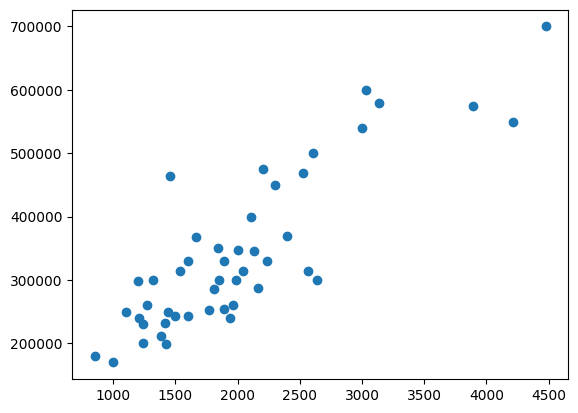

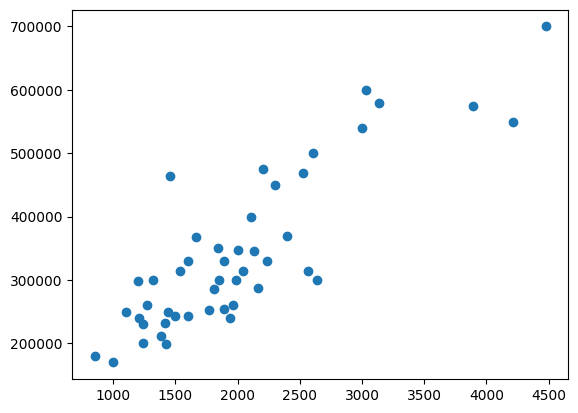

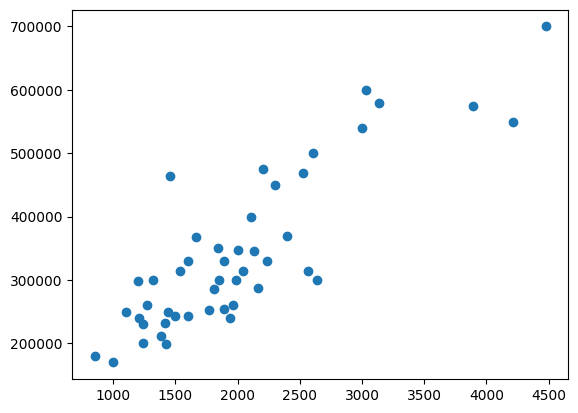

In [ ]:
#feeding the data in the functions
training_data = dataset.dropna()
training_data.shape

# Use 'area' and 'rooms' as features (x) and 'price' as the target (y)
x_value = training_data[['area', 'rooms']].values
y_value = training_data['price'].values.reshape(-1, 1) # Reshape y_value to be a column vector


# Assuming alpha and iters are defined elsewhere or need to be defined
alpha = 0.01
iters = 1500

cost_values, theta = training(x_value, y_value, alpha, iters)


x_axis = np.arange(0, len(cost_values), step=1)
plt.plot(x_axis, cost_values)
plt.xlabel("Number of iterations")
plt.ylabel("Cost J")
plt.title("Cost function over iterations")
plt.show()

In [ ]:
#Task try to work with some generalise function